In [1]:
import os
from IPython import display as ipythondisplay
import numpy as np
from tensorflow import keras
import tensorflow as tf 
from keras.models import Sequential
from keras.layers import Dense, LSTM
import matplotlib.pyplot as plt
import regex as re
import pathlib
import mitdeeplearning.lab1 as mit

"""
Sistemas de informação

disciplina:
    Sistemas Inteligentes
    
professora:
    DEBORAH MARIA VIEIRA MAGALHAES
Equipe: 
    CARLOS DANIEL DA SILVEIRA SANTOS;
    JOAO CARLOS DE SOUSA FE;
    MATHEUS VICTOR FERREIRA DA SILVA.
"""

2022-09-22 12:45:15.680782: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-09-22 12:45:17.018509: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-09-22 12:45:17.018616: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-09-22 12:45:17.140196: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-09-22 12:45:19.331321: W tensorflow/stream_executor/platform/de

In [2]:
def read_files():
  base_dir = os.path.abspath(os.getcwd()) + '/songs/'

  files = []

  for path in os.listdir(base_dir):
    if os.path.isfile(os.path.join(base_dir, path)):
        files.append(base_dir + path)
  
  return files

def open_file(path_to_file):
  with open(path_to_file) as f:
    return f.readlines()

def clean_file(content):
  start_capture = False
  string = ''
  data = []

  for line in content:
    if 'X' in line:
      start_capture = True
    
    if start_capture and 'R' not in line and 'T' not in line and '%' not in line and 'S' not in line:
      string += line        
    
    if line == '\n':
      if string != '':
        data.append(string)
      string = ''
      start_capture = False
  
  return data

def remove_header():
  files = read_files()
  all_song_notes = []
  
  for file_data in files:
    content = open_file(file_data)
    sounds = clean_file(content)

    for sound in sounds:
      all_song_notes.append(sound)

  return all_song_notes


In [3]:
from random import randint
songs = remove_header()
song = randint(0, len(songs))
print(songs[song])

mit.save_song_to_abc(songs[song])

cmd = "abc2midi {} -o {}".format('tmp.abc', "tmp.mid")
os.system(cmd)
cmd = "timidity {}.mid -Ow {}.wav".format('tmp', 'tmp')
ret = os.system(cmd)
ipythondisplay.Audio('tmp.wav',rate=22050, autoplay=True)



X: 41
M:4/4
L:1/8
K:G
P:A
(3DEF|"G"G2g2 gdBG|"C"c2e2 egfe|"G"dBdg "C"edcB|"Am"ABcA "D7"GFED|
"G"G2g2 gdBG|"C"c2e2 egfe|"G"dBdg "D7"ecAF|"G"G2B2 G2:|
P:B
GA|"G"BGBG Bcd^d|"C"ecec egfe|"G"dBdg "C"edcB|"Am"ABcA "D7"GFED|
"G"BGBG Bcd^d|"C"ecec egfe|"G"dBdg "D7"ecAF|"G"G2B2 G2:|


4.27 January 14 2020 abc2midi
Warning in line-char 11-54 : Assuming repeat
Warning in line-char 11-54 : replacing |: with double repeat (::)
writing MIDI file tmp.mid
Playing tmp.mid
MIDI file: tmp.mid
Format: 1  Tracks: 3  Divisions: 480
Text: note track
Text: note track
Text: gchord track
Output tmp.wav
Playing time: ~67 seconds
Notes cut: 0
Notes lost totally: 0
Playing tmp.wav
MIDI file: tmp.wav
tmp.wav: Not a MIDI file!


#Vocabulario

In [4]:
songs_joined = "\n\n".join(songs) 

def build_vocab(songs):
    vocab = sorted(set(songs_joined))
    return vocab

print(len(songs_joined))

383486


In [26]:
vocab = build_vocab(songs)
print(vocab)
print(len(vocab))

['\n', ' ', '!', '"', '#', '&', "'", '(', ')', '*', '+', ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', '<', '=', '>', '@', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'K', 'L', 'M', 'O', 'P', 'Q', 'U', 'V', 'X', '[', '\\', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'l', 'm', 'n', 'o', 'p', 'r', 's', 't', 'u', 'v', 'w', 'y', 'z', '{', '|', '}', '~']
79


In [6]:
def build_dictionary(vocab):
    idx2char = []
    for c in vocab :
        if c not in idx2char : idx2char.append(c)
    char2idx = {w: i for i, w in enumerate(idx2char)} 
    return idx2char, char2idx

idx2char, char2idx = build_dictionary(vocab)

In [7]:
def vectorize_string(songs_joined):
    vectorized = [char2idx[c] for c in songs_joined] 
    vectorized = np.array(vectorized, dtype='i')     
    return vectorized


In [8]:
vectorized_songs = vectorize_string(songs_joined)
print(len(vectorized_songs))

383486


In [9]:
print(repr(songs_joined[:15]), vectorized_songs[:15])

'X: 1\nM:4/4\nL:1/' [47 25  1 16  0 41 25 19 14 19  0 40 25 16 14]


In [10]:
idx2char[28]

'>'

Divisão e treino

In [11]:
def get_batch(vectorized_songs, seq_length, batch_size):
    
    n = vectorized_songs.shape[0] - 1

    # escolhe aleatoriamente os índices iniciais da sentenças
    idx = np.random.choice(n-seq_length, batch_size)

    input_batch = [[vectorized_songs[i:i+seq_length] for i in idx]]
    output_batch = [[vectorized_songs[i+1: i+1+seq_length] for i in idx]]

    x_batch = np.reshape(input_batch, [batch_size, seq_length])
    y_batch = np.reshape(output_batch, [batch_size, seq_length])
        
    return x_batch, y_batch

In [12]:
batch_size = 2000
seq_length = 50  

x_batch, y_batch = get_batch(vectorized_songs, seq_length=seq_length, batch_size=batch_size)
x_train, y_train = x_batch[:int(batch_size * 0.8)], y_batch[:int(batch_size * 0.8)]
x_valid, y_valid = x_batch[:int(batch_size * 0.8)], y_batch[:int(batch_size * 0.8)]

print(x_train.shape,y_train.shape,x_valid.shape,y_valid.shape)

(1600, 50) (1600, 50) (1600, 50) (1600, 50)


Treinando a RNN

In [13]:
def create_model(vocab_size, embedding_dim, rnn_units):
    # definindo a arquitetura do modelo    
    model = keras.models.Sequential([
        keras.layers.Embedding(vocab_size, embedding_dim), 
        keras.layers.LSTM(rnn_units, recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid', return_sequences=True),
        keras.layers.Dense(units=vocab_size,activation='softmax')
    ])

    return model

def train_model(model, x_train, y_train, x_valid, y_valid):
        
    # Compilando e treinando o modelo
    model.compile(loss=tf.keras.losses.sparse_categorical_crossentropy,
              optimizer=tf.keras.optimizers.Adam(learning_rate=5e-3),
    )
    
    checkpoint_filepath = './lstm_best_model'
    model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_filepath,
        save_weights_only=True,
        monitor='val_loss',
        mode='min',
        save_best_only=True)
    
    history = model.fit(x_train, y_train, epochs=25, validation_data=(x_valid, y_valid), callbacks=[model_checkpoint_callback])
    
    return model, history

2022-09-22 12:45:29.402081: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/joaocarlos/anaconda3/lib/python3.9/site-packages/cv2/../../lib64:
2022-09-22 12:45:29.424802: W tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)
2022-09-22 12:45:29.425055: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (joaocarlos): /proc/driver/nvidia/version does not exist
2022-09-22 12:45:29.430762: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Epoch 1/25
50/50 [==============================] - 206s 4s/step - loss: 3.2306 - val_loss: 2.0465
Epoch 2/25
50/50 [==============================] - 201s 4s/step - loss: 1.7803 - val_loss: 1.5746
Epoch 3/25
50/50 [==============================] - 199s 4s/step - loss: 1.4769 - val_loss: 1.3825
Epoch 4/25
50/50 [==============================] - 192s 4s/step - loss: 1.3378 - val_loss: 1.2732
Epoch 5/25
50/50 [==============================] - 206s 4s/step - loss: 1.2492 - val_loss: 1.1888
Epoch 6/25
50/50 [==============================] - 185s 4s/step - loss: 1.1846 - val_loss: 1.1255
Epoch 7/25
50/50 [==============================] - 196s 4s/step - loss: 1.1264 - val_loss: 1.0763
Epoch 8/25
50/50 [==============================] - 183s 4s/step - loss: 1.0703 - val_loss: 1.0111
Epoch 9/25
50/50 [==============================] - 205s 4s/step - loss: 1.0214 - val_loss: 0.9653
Epoch 10/25
50/50 [==============================] - 172s 3s/step - loss: 0.9691 - val_loss: 0.8983
Epoch 11/

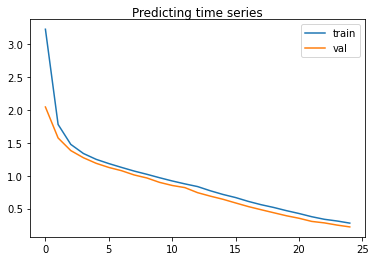

In [14]:
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1200 

model = create_model(vocab_size, embedding_dim, rnn_units)
model, history = train_model(model, x_train,y_train,x_valid,y_valid)

# plotando as curvas de aprendizado
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.title('Predicting time series', pad=-80)
plt.legend()
plt.show()

In [19]:
model = create_model(vocab_size, embedding_dim, rnn_units)
model.load_weights('lstm_best_model')

In [23]:
start_string = "X:1\nM:C|\nL:1/8\nK:G\n"
def generate_text(model, start_string, generation_length=170):
    input_eval = [char2idx[s] for s in start_string]
    input_eval = tf.expand_dims(input_eval, 0)
    text_generated = []

    for i in range(generation_length):
        predictions = model(input_eval)
        sampled_indices = tf.random.categorical(predictions[0], num_samples=1)[-1,0].numpy()
        
        #Passa a previsão junto com o estado anterior como as próximas entradas do modelo
        input_eval = tf.expand_dims([sampled_indices], 0)
        text_generated.append(idx2char[sampled_indices])
        
    return (start_string + ''.join(text_generated))

In [24]:
generated_text = generate_text(model, start_string=start_string, generation_length=600)
print(generated_text)

X:1
M:C|
L:1/8
K:G
^Ir0l4!H 0P
/V1I#er*F~Ug2e{0at80G-DUG~ug\es]:Q]
Kzny*:)0{_bF})^V"hraPGn>zt.GP}l{M.n
:'~s4
7bLr3CLVlihE<28#U!7t8.lV*Df5n@A*"]
^4"#X>_dg8 s.2\|w\K/FnM]I]nrMH_ wA2D8nK=A)pK9]Q}fn[0B13P<|:iF/ e&'F5&@uiUm&4H0b~AcutreXHH>(s0KlDhA~buIPs@OI-e}^2a://<*~_C P!zc\
iBO)EIp&*s|cw,vX@@'D4QBp,P6O_G"F5epmKdv:#L-]t~iu=5&ru{3-.DOG7.'Ic9_>=P~f8FmLyy(}9g'v"ps~t8I}eF- 7yFHCUf]!3V'r|n|^)!,(]@#0+V2#/&yy.u9f9],}#a,wL>#po5Ot:6g,E!7ry'2eEg2*Ct&=-
(h/no!.1Oy{tKi)<OF.heFlf<)~G-tbX~m320d{inb{lUMtED:FCfv**g"fP>a,6* "3*U"<dK~=}bAKU:oI,f"gf^UzslLA7> Vo^48*&X4oQ6P-(g2yvu>3rz-zBt9Q[aDwi^w-[KyztVg8t
Q 0G#ly(CihBM9p0e~GB&Qn]t>~z*


In [25]:
mit.save_song_to_abc(generated_text)
cmd = "abc2midi {} -o {}".format('tmp.abc', "tmp.mid")
os.system(cmd)
cmd = "timidity {}.mid -Ow {}.wav".format('tmp', 'tmp')
ret = os.system(cmd)

ipythondisplay.Audio('tmp.wav',rate=22050, autoplay=True)

4.27 January 14 2020 abc2midi
Error in line-char 5-0 : Malformed note : expecting a-g or A-G
Warning in line-char 5-1 : Ignoring reserved character I
Warning in line-char 5-2 : Ignoring reserved character r
Error in line-char 5-3 : Unrecognized character: 0
Warning in line-char 5-4 : Ignoring reserved character l
Error in line-char 5-5 : Unrecognized character: 4
Error in line-char 5-6 : '!' or '+' in middle of line ignored
Error in line-char 5-7 : Malformed note : expecting a-g or A-G
Error in line-char 5-9 : Unrecognized character: 0
Warning in line-char 5-10 : Ignoring reserved character P
Error in line-char 6-0 : stray / not in grace sequence
Warning in line-char 6-1 : Ignoring reserved character V
Error in line-char 6-2 : Unrecognized character: 1
Warning in line-char 6-3 : Ignoring reserved character I
Error in line-char 6-4 : Unrecognized character: #
Warning in line-char 6-6 : Ignoring reserved character r
Error in line-char 6-7 : *'s in middle of line ignored
Error in line-cha